# Generate meta-data and wordclouds for all companies 

In [2]:
import Preprocessing

companies = Preprocessing.execute("SELECT searchterm FROM tweet GROUP BY searchterm;")
companies = list(map(lambda x: x[0][1:], companies))
companies

['Adobe',
 'airliquidegroup',
 'Alstom',
 'ArcelorMittal',
 'Capgemini',
 'Cisco',
 'ENGIEgroup',
 'Forrester',
 'Generalelectric',
 'Intel',
 'MaerskLine',
 'Oracle',
 'orexad',
 'orexad_FR',
 'PublicisGroupe',
 'Rexel_Group',
 'SAFRAN',
 'Salesforce',
 'SolvayGroup',
 'TechnipGroup',
 'VMware',
 'VolvoTrucksFR']

### Preprocess tweets
time-consuming, see Preprocessing.py

In [3]:
data = []
for name in companies:
    %time data.append( Preprocessing.preprocessing( name, "en" ) )

CPU times: user 14min 8s, sys: 2.98 s, total: 14min 11s
Wall time: 14min 11s
CPU times: user 2min 7s, sys: 388 ms, total: 2min 7s
Wall time: 2min 8s
CPU times: user 1min 36s, sys: 356 ms, total: 1min 36s
Wall time: 1min 36s
CPU times: user 1min 47s, sys: 308 ms, total: 1min 47s
Wall time: 1min 48s
CPU times: user 11min 15s, sys: 2.09 s, total: 11min 17s
Wall time: 11min 17s
CPU times: user 13min 37s, sys: 3.19 s, total: 13min 41s
Wall time: 13min 41s
CPU times: user 4min 8s, sys: 776 ms, total: 4min 9s
Wall time: 4min 9s
CPU times: user 14min 4s, sys: 2.9 s, total: 14min 7s
Wall time: 14min 7s
CPU times: user 8min 41s, sys: 1.64 s, total: 8min 43s
Wall time: 8min 43s
CPU times: user 34min 56s, sys: 6.88 s, total: 35min 3s
Wall time: 35min 3s
CPU times: user 2min 27s, sys: 388 ms, total: 2min 27s
Wall time: 2min 28s
CPU times: user 20min 35s, sys: 4.14 s, total: 20min 39s
Wall time: 20min 39s
CPU times: user 20.6 ms, sys: 2 µs, total: 20.6 ms
Wall time: 927 ms
CPU times: user 77.4 ms, s

### Save preprocessed tweets in json file

In [6]:
import json

with open("tweets.json", 'w') as fd:
    json.dump(json.dumps(data), fd)

raw_data = json.load(open("tweets.json")) 
data = json.loads(raw_data)

### Explore meta-data

In [236]:
import numpy as np
import pandas as pd

# get data
val = []
for company in data:
    name, nb_tw, nb_rtw, _, nb_lang_tw, nb_wds, nb_u_wds, _ = company
    val.append( [ name, nb_tw, nb_rtw, nb_lang_tw, nb_wds, nb_u_wds ] )
val = np.array(val)

# insert total row
total = np.concatenate( [ ["Total"], np.delete(val, [0], axis=1).astype(np.int).sum(axis=0) ] )
val = np.insert(val, 0, total, axis=0)

# sort by nb_tweets
val = np.array(sorted(val, key=lambda x: -int(x[1])))

# prepare for df
index = val[:,0]
val = np.delete(val, [0], axis=1).astype(int)

# calc total tweets percentage, and local english tweets percentage
perc_tw = np.array(list(map(lambda x : x[0] / int(total[1]), val))) * 100
loc_per_eng = np.array(list(map(lambda x : x[2] / x[0], val))) * 100

# insert perc
val = np.insert(val, 1, perc_tw, axis=1)
val = np.insert(val, 4, loc_per_eng, axis=1)

col = ["nb tweets", "% total tweets", "nb retweets", "nb eng tweets", "% local eng tweets", "nb words", "unique words"]
pd.DataFrame(val ,index=index, columns=col)

,nb tweets,% total tweets,nb retweets,nb eng tweets,% local eng tweets,nb words,unique words
Total,1429334,100,839613,1294840,90,7931800,363846
Salesforce,301288,21,176267,288144,95,1700982,53399
Intel,268927,18,162246,248167,92,1496272,56913
Oracle,167369,11,94133,157150,93,991003,40607
Cisco,121239,8,69673,112853,93,675287,33369
Adobe,115396,8,62567,109348,94,654629,35916
Forrester,114563,8,64396,109875,95,780529,21597
Capgemini,79118,5,50890,72300,91,471090,22845
VMware,73947,5,44413,70099,94,432510,22394
Generalelectric,65515,4,36667,59342,90,324576,25508


### generate wordclouds

Adobe


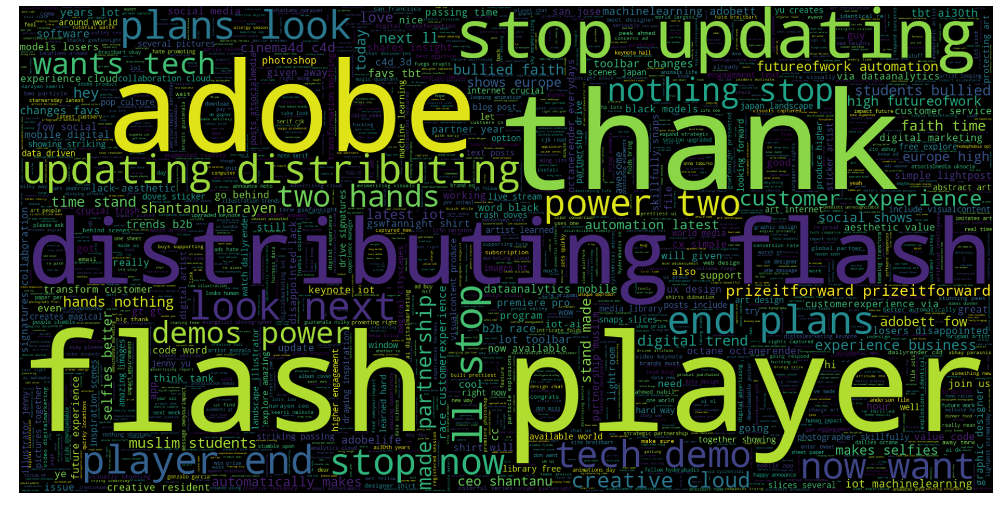

airliquidegroup


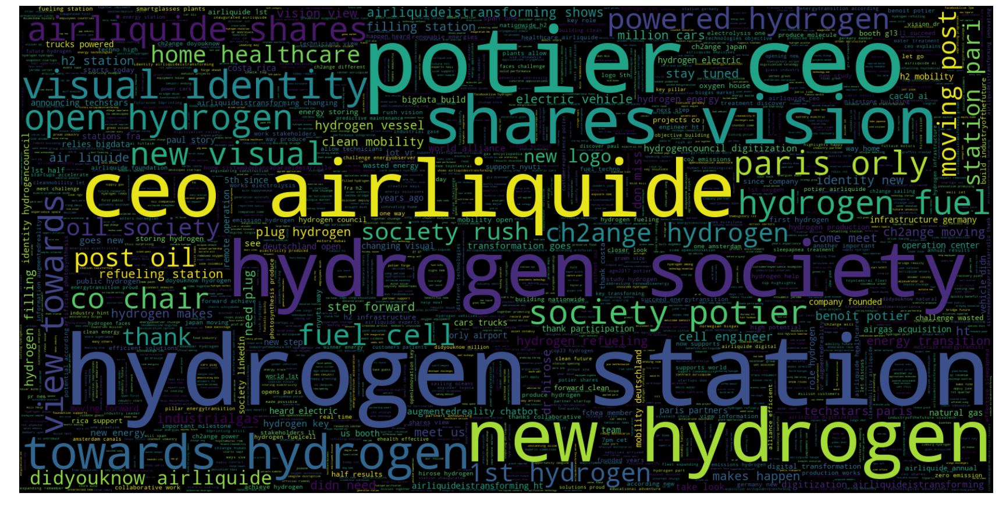

Alstom


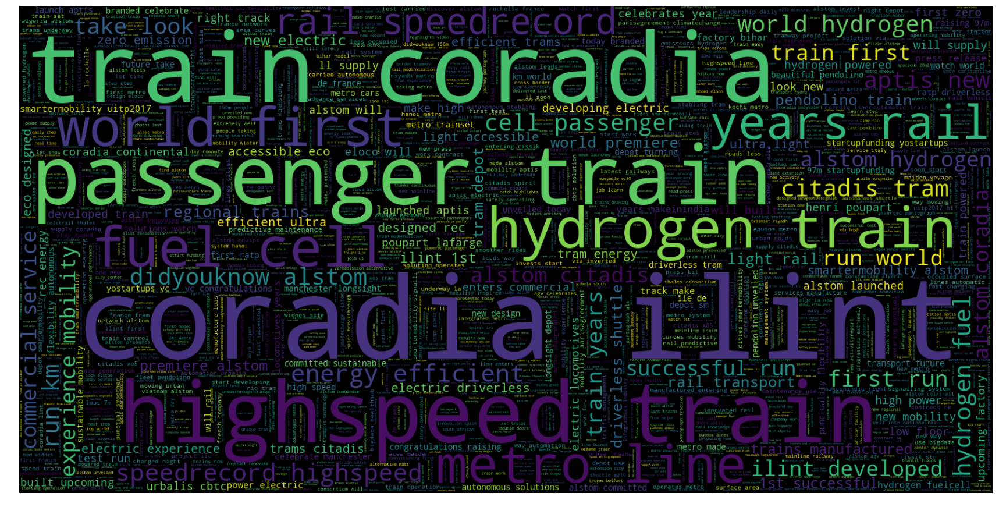

ArcelorMittal


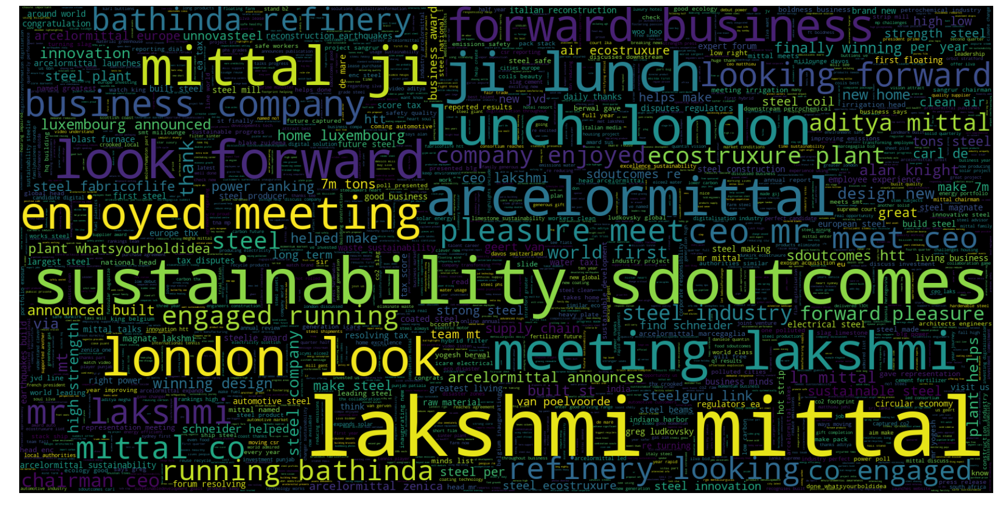

Capgemini


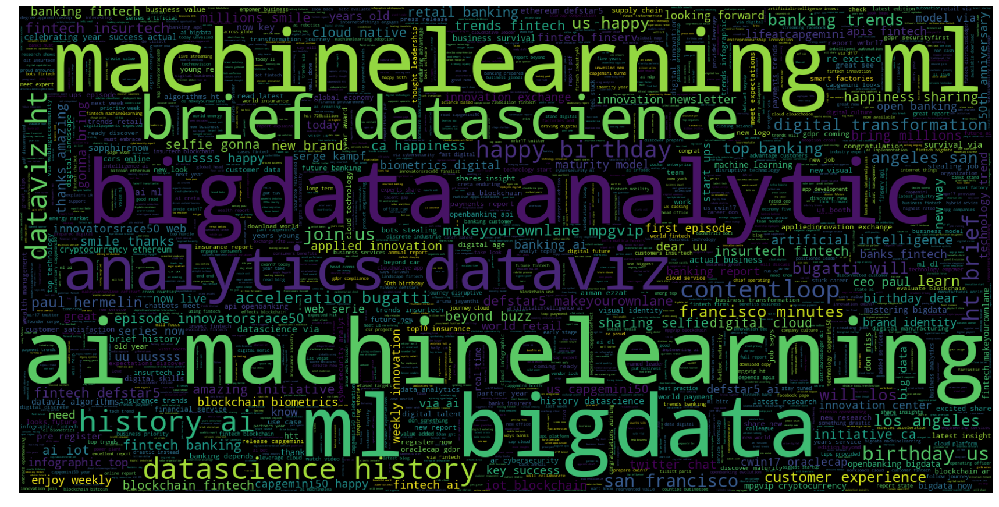

Cisco


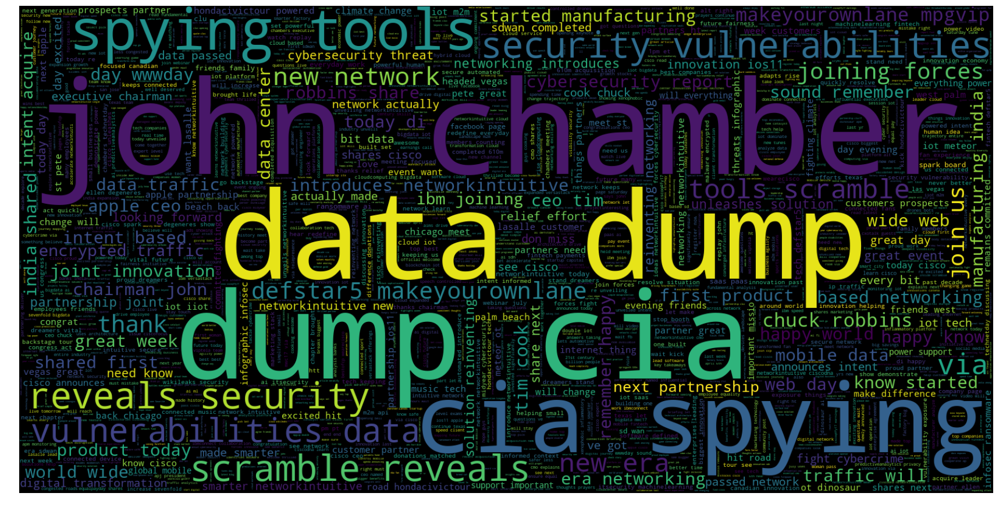

ENGIEgroup


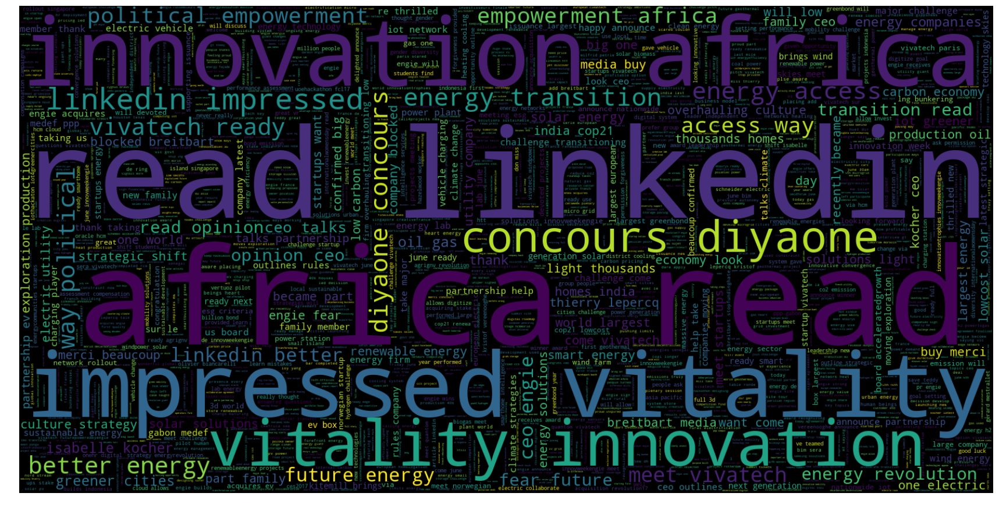

Forrester


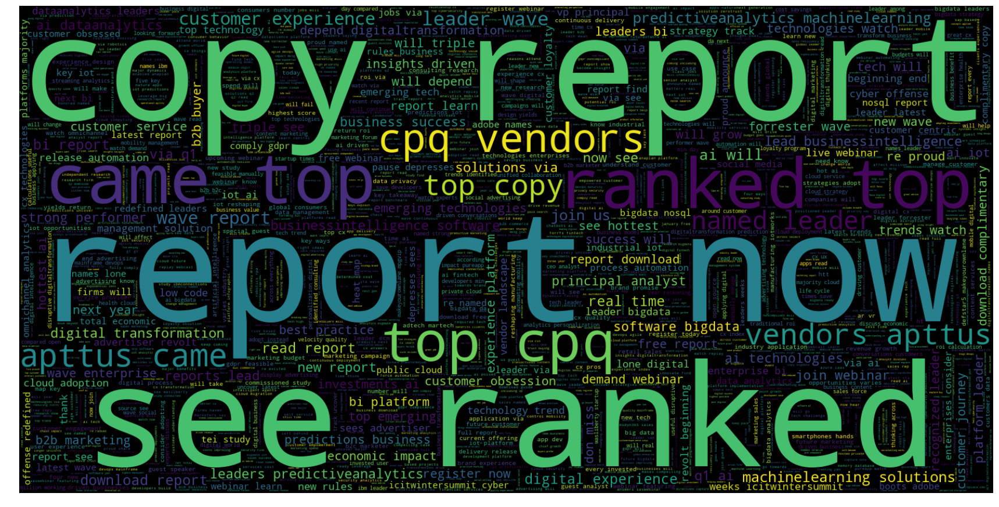

Generalelectric


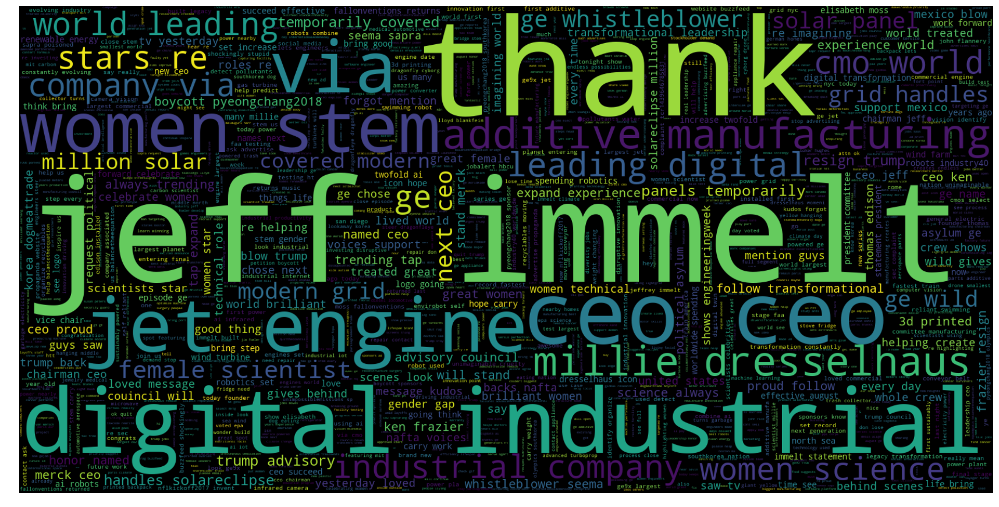

Intel


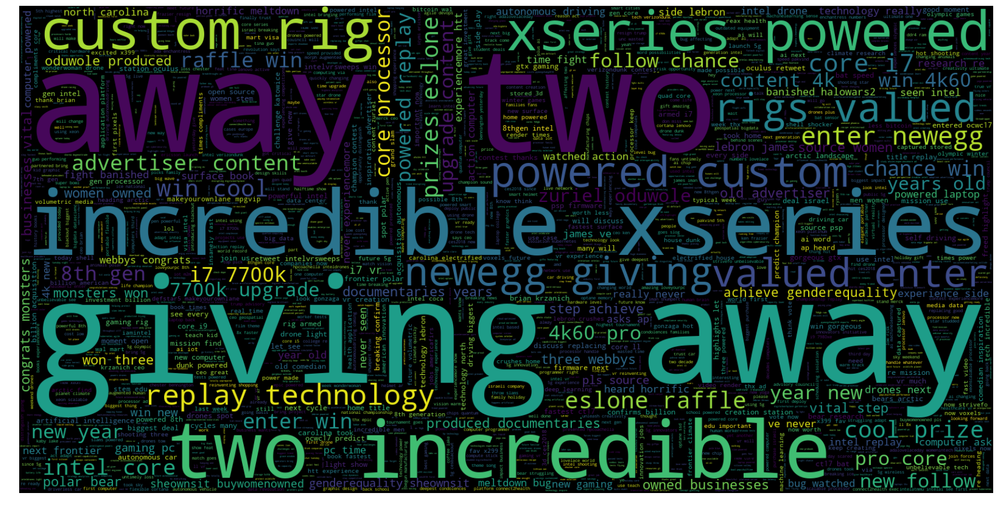

MaerskLine


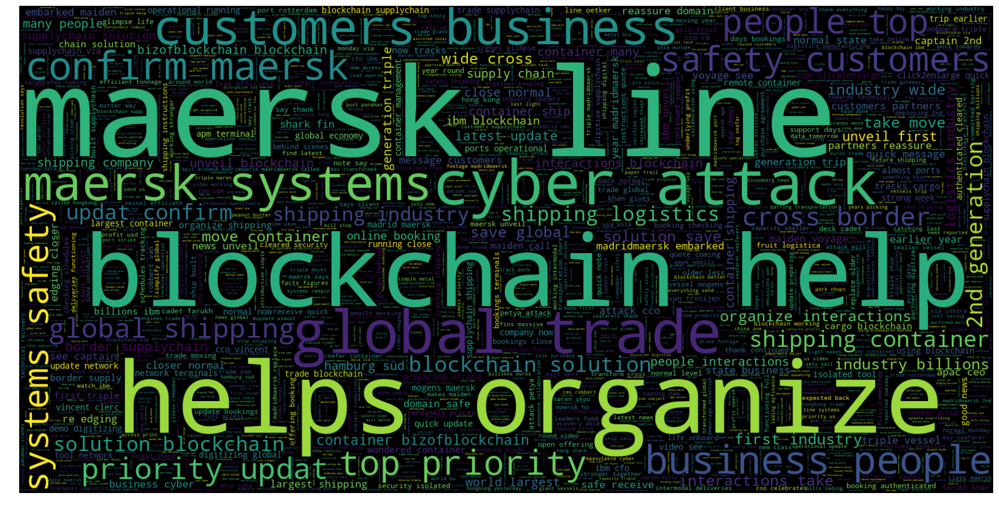

Oracle


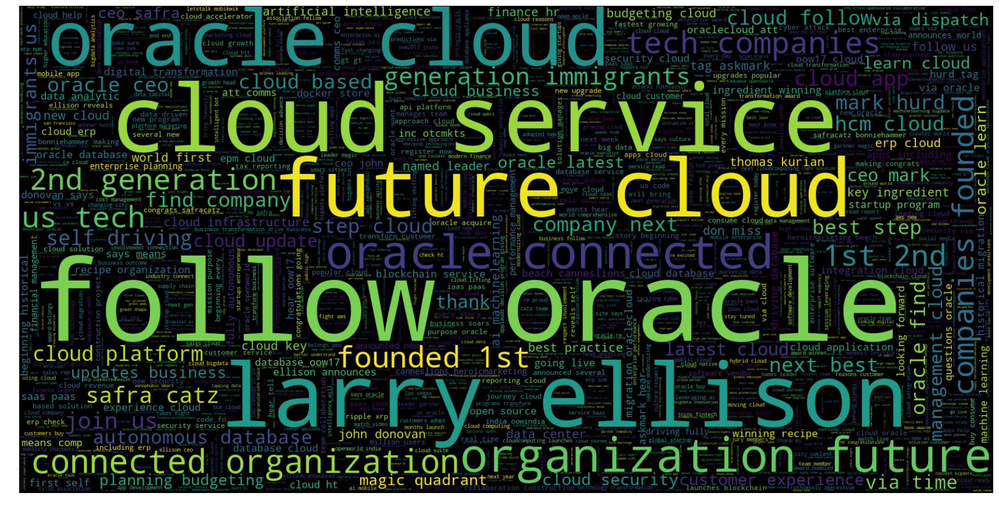

PublicisGroupe


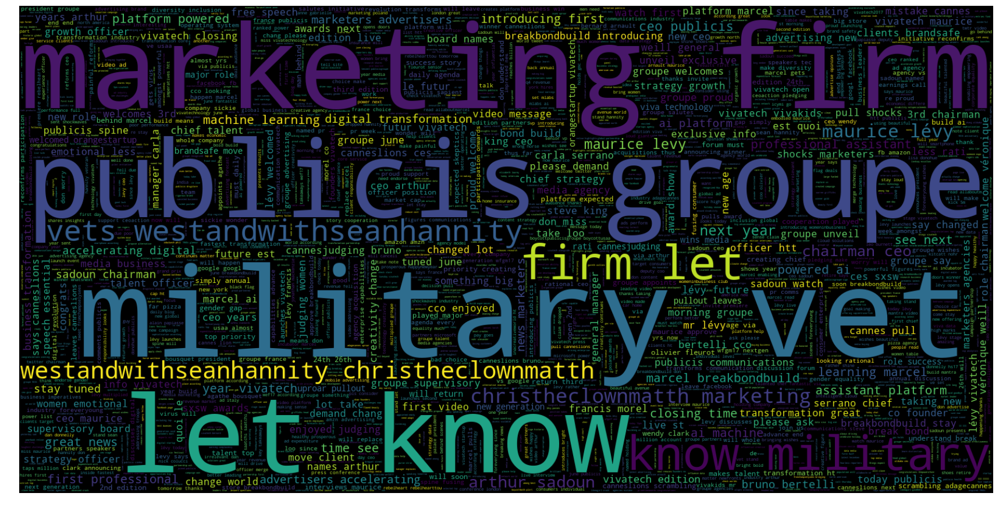

Rexel_Group


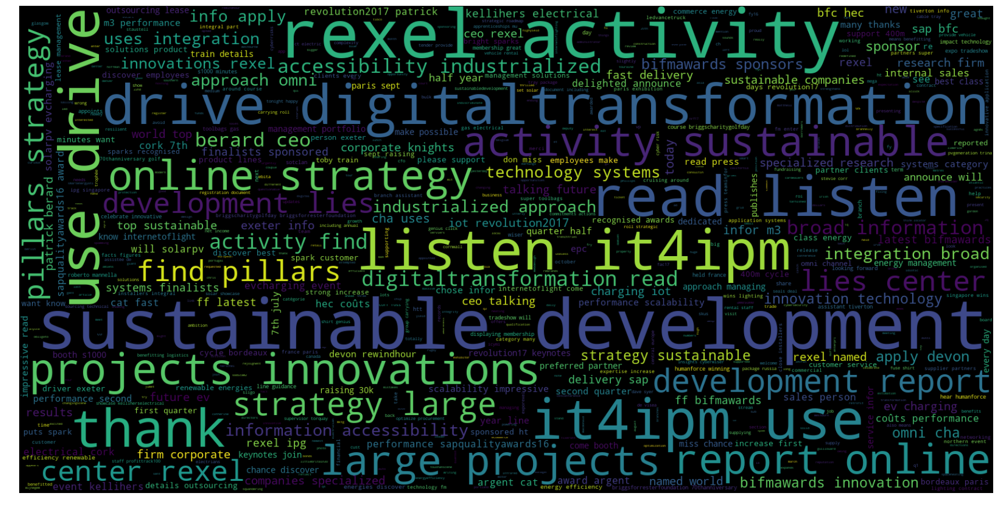

SAFRAN


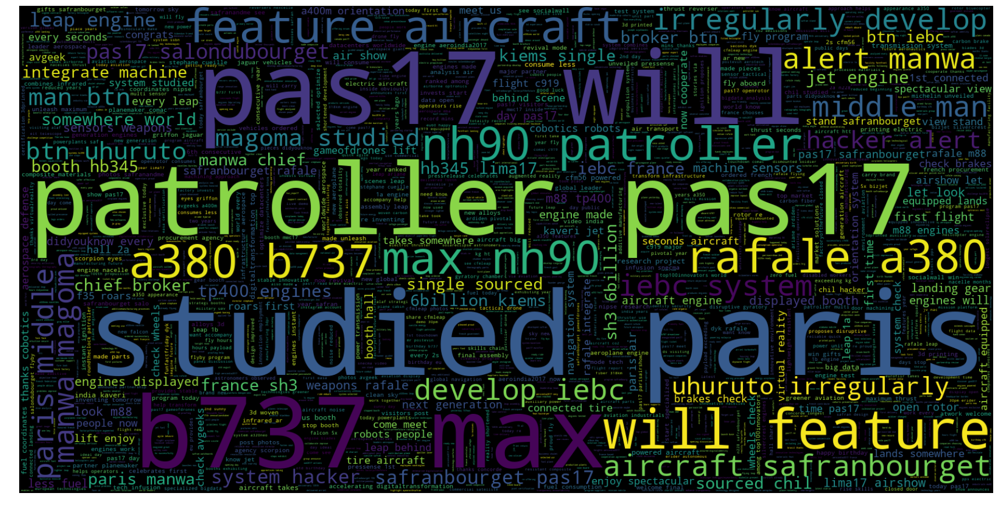

Salesforce


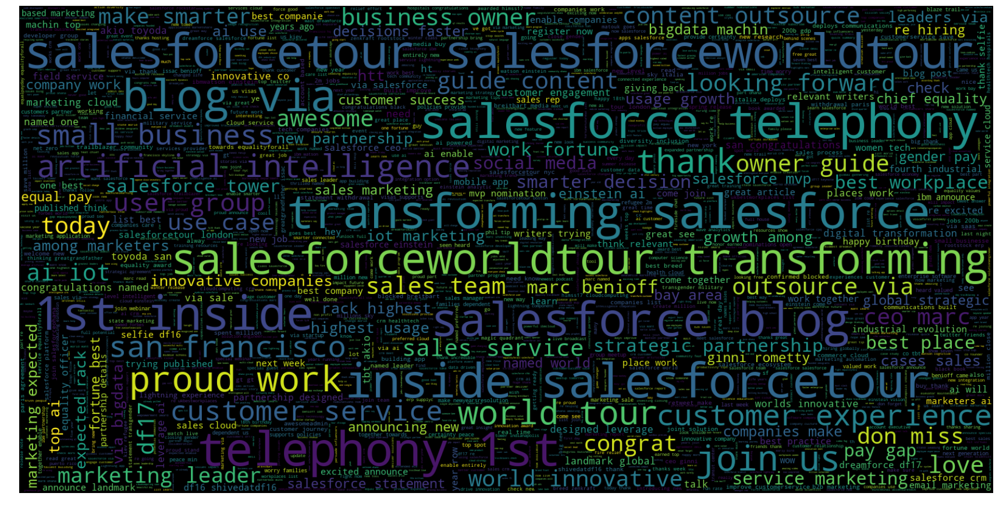

SolvayGroup


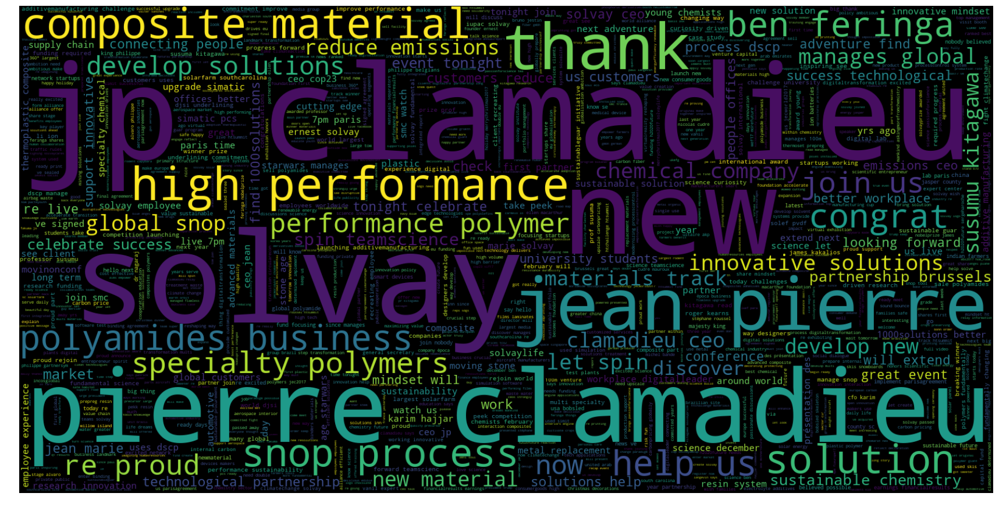

TechnipGroup


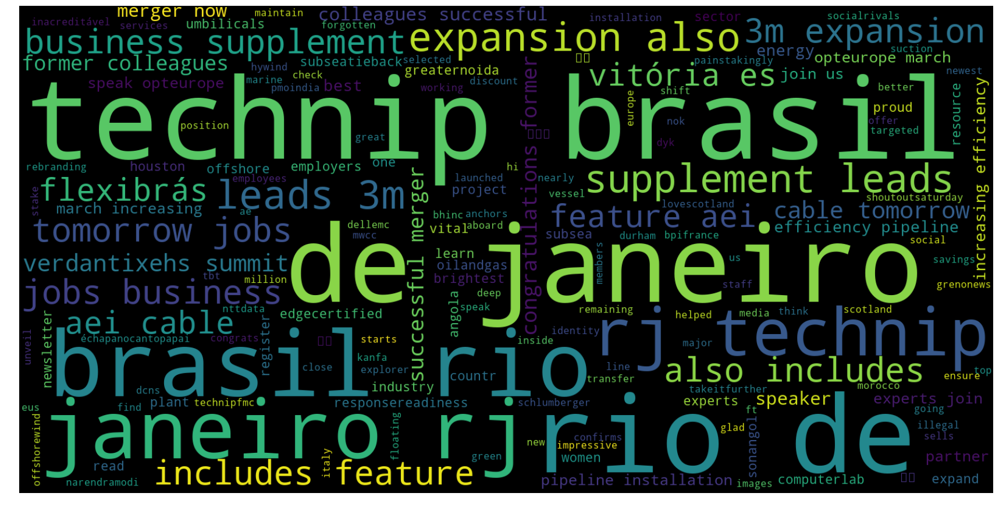

VMware


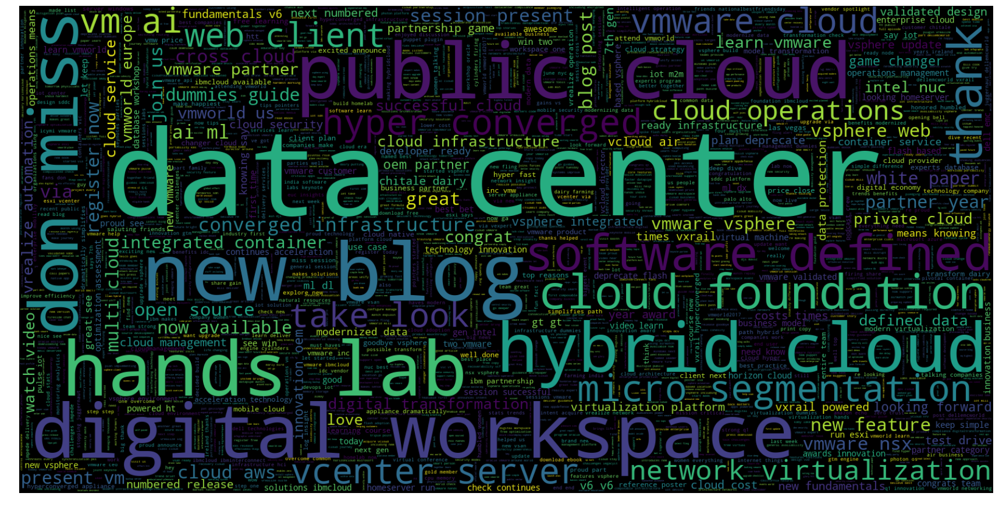

VolvoTrucksFR


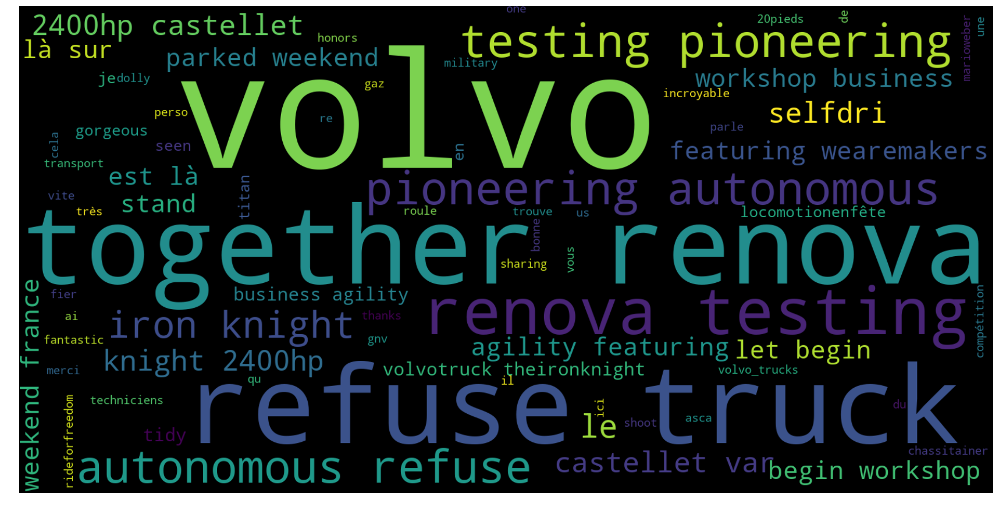

In [259]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

for company in data:
    name, _, _, _, _, _, _, tweets = company
    flat_list = [ word for tweet in tweets for word in tweet ]

    if len(flat_list) > 1:
        print (name)
    
        wordcloud = WordCloud(width=1600, height=800, max_words=2000).generate(" ".join(flat_list))

        plt.figure(figsize=(30, 30))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis("off")
        plt.show()

save to disk

In [ ]:
for company in data:
    name, _, _, _, _, _, _, tweets = company
    flat_list = [ word for tweet in tweets for word in tweet ]

    if len(flat_list) > 1:
        wordcloud = WordCloud(width=1600, height=800, max_words=2000).generate(" ".join(flat_list))

        image = wordcloud.to_image()
        image.save("wordclouds/wordcloud_" + name + ".png")

### save most frequent words

In [ ]:
name, _, _, _, _, _, _, tweets = company[0]